In [200]:
import pandas as pd
import numpy as np
import shap
from torch import nn
from torch.utils.data import DataLoader, ConcatDataset
from math import log, e
import json
import matplotlib
from scipy.special import rel_entr, kl_div 
import shap
import matplotlib.pyplot as plt
import torch
import random
from torch import nn, optim
import torch.nn.functional as F
import Net

features = ['B cells naive', 'B cells memory', 'Plasma cells', 'T cells CD8',
      'T cells CD4 naive', 'T cells CD4 memory resting',
      'T cells CD4 memory activated', 'T cells follicular helper',
      'T cells regulatory (Tregs)', 'T cells gamma delta', 'NK cells resting',
      'NK cells activated', 'Monocytes', 'Macrophages M0', 'Macrophages M1',
      'Macrophages M2', 'Dendritic cells resting',
      'Dendritic cells activated', 'Mast cells resting',
      'Mast cells activated', 'Eosinophils', 'Neutrophils', 'Cell_Cycle',
      'HIPPO', 'MYC', 'NOTCH', 'NRF2', 'PI3K', 'TGF.Beta', 'RTK_RAS', 'TP53',
      'WNT', 'Hypoxia', 'SRC', 'ESR1', 'ERBB2', 'PROLIF','stage','grade']

params = {
    'k_folds': 5,  
    'lr':0.01,
    'epochs':120,
    'batch_size':200,
    'fc1':200,
    'fc2':120,
    'fc3':84,
    'dropout':0.2
}

In [201]:
GENERATED_FOLDER = "data/generated/"
DATA_PATH = GENERATED_FOLDER + "clean_train.csv"

df = pd.read_csv(DATA_PATH)
df['PAM50'] = df['PAM50'].astype('category')
df['PAM50'] = df['PAM50'].cat.codes.values

X = df[features]
y = df["PAM50"]
X = X.to_numpy(dtype=float)
y = y.to_numpy()

model = Net.Net(len(features), params)
model.load_state_dict(torch.load('model/model.pth'))

model.eval()
X_val = torch.FloatTensor(X)
y_val = torch.LongTensor(y)

y_pred = model(X_val)

ncorrect = (torch.max(y_pred, 1)[1] == y_val).sum().item()
    
#print(str(ncorrect) + "/" + str(len(X_data)) + "=" + str(ncorrect/len(X_data)))
total_acc = ncorrect/len(X)*100

In [202]:
background = X[np.random.choice(X.shape[0], 100, replace=False)]
e = shap.DeepExplainer(model, torch.FloatTensor(background))

list_of_tensors = torch.FloatTensor(X)
shap_values = e.shap_values(list_of_tensors)

Using a non-full backward hook when the forward contains multiple autograd Nodes is deprecated and will be removed in future versions. This hook will be missing some grad_input. Please use register_full_backward_hook to get the documented behavior.


KeyboardInterrupt: 

In [ ]:
import torch.nn.functional as nnf
prob = nnf.softmax(y_pred, dim=1)

top_p, top_class = prob.topk(1, dim = 1)

In [ ]:
SHAP_VALUES = []
indx = []
for patient in range(len(shap_values[0])):
    SHAP_VALUES.append(shap_values[0][patient])
    if y_val[patient] == 0:
        tumor = "Basal"
    elif y_val[patient] == 1:
        tumor = "Her2"
    elif y_val[patient] == 2:
        tumor = "LumA"
    elif y_val[patient] == 3:
        tumor = "LumB"
    indx.append(tumor + " - ")

id = indx + df['submitter']

In [ ]:
d = {'shap_values': SHAP_VALUES, 'target': y_val}

def que(x):
    if x['target'] == x['pred']:
        return 1
    return 0

df3 = pd.DataFrame(data=d)
df3 = pd.DataFrame(df3['shap_values'].to_list(), columns=features)

df4 = pd.DataFrame(data=d)
df4 = pd.DataFrame(df4['shap_values'].to_list(), columns=features)

In [ ]:
df3[df3 < 1] = df3[df3 < 1].transform(lambda x: -np.log(-x + 1))
df3[df3 > 1] = df3[df3 > 1].transform(lambda x: np.log(x + 1))

df4[df4 < 1] = df4[df4 < 1].transform(lambda x: -np.log(-x + 1))
df4[df4 > 1] = df4[df4 > 1].transform(lambda x: np.log(x + 1))

In [ ]:
df3['target'] = y_val
df3['pred'] = top_class.detach().numpy().flatten()
df3['result'] = df3.apply(que, axis=1)
df3['top_p'] = top_p.detach().numpy().flatten()
df3['softmax'] = [l.tolist() for l in prob.detach().numpy()]
df3['pred'] = df3['pred'].map({0: 'Basal', 1: 'Her2', 2: 'LumA', 3: 'LumB'})
df3['target'] = df3['target'].map({0: 'Basal', 1: 'Her2', 2: 'LumA', 3: 'LumB'})
df3 = df3.set_index([id])
df3 = df3.sort_index()

df4 = df4.set_index([id])
df4 = df4.sort_index()
#res = [i + " " + j for i, j in zip(df3['result'].astype(str), df4.index)]
#df4 = df4.set_index([res])
#df4 = df4.sort_index()
df_all_transposed = df4.transpose()

In [191]:
A = df3[['softmax','result']]
A = A.set_index([id]).sort_index()
i = df3['softmax'][df3['result']==1].index
SOFTMAX = pd.DataFrame(df3['softmax'][df3['result']==0].to_list(), columns=['Basal','Her2','LumA','LumB']).set_index(i)

savefig() got unexpected keyword argument "figsize" which is no longer supported as of 3.3 and will become an error two minor releases later


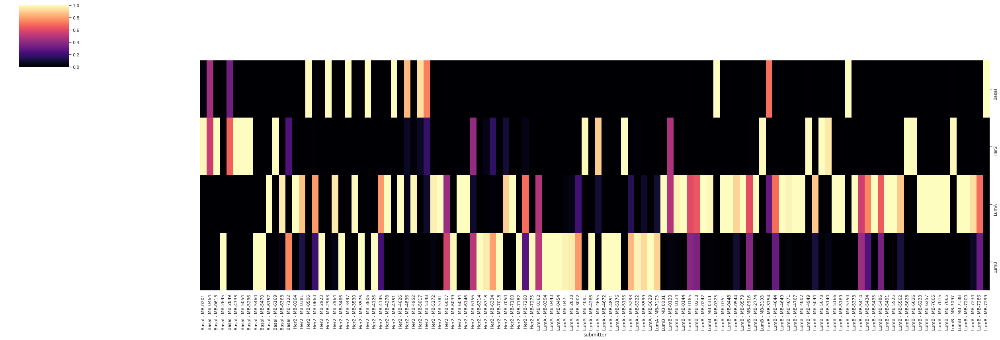

In [199]:
sns.clustermap(SOFTMAX.transpose(),row_cluster=False, col_cluster=False, cmap='magma', figsize=(35,12))
plt.savefig('heatmap_with_Seaborn_clustermap_python.jpg',figsize=(25,12))

In [208]:
lut1 = dict(zip(df3['result'].unique(), ['g','r']))
row_colors1 = df3['result'].map(lut1)
lut2 = dict(zip(df3['target'].unique(), ['darkred','orange','dodgerblue','indigo']))
row_colors2 = df3['target'].map(lut2)
row_colors = pd.concat([row_colors1,row_colors2],axis=1)

Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
savefig() got unexpected keyword argument "figsize" which is no longer supported as of 3.3 and will become an error two minor releases later


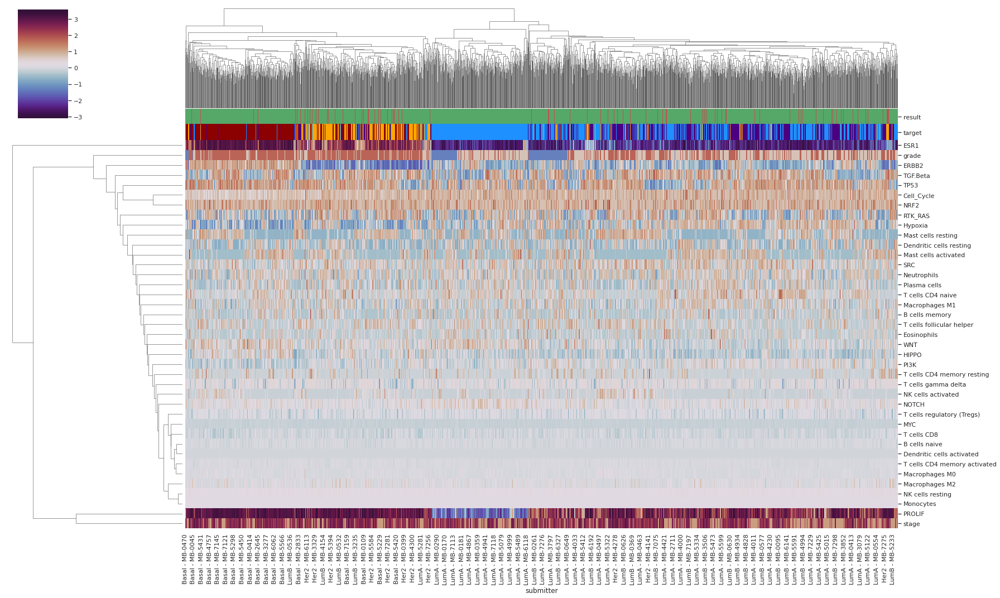

In [214]:
import seaborn as sns
from matplotlib import pyplot as plt
%matplotlib inline

sns.clustermap(df_all_transposed, col_colors=row_colors, row_cluster=True, col_cluster=True, cmap="twilight_shifted", figsize=(25,15))
plt.savefig('heatmap_with_Seaborn_clustermap_python.jpg',figsize=(25,15))

In [ ]:


    background = X[np.random.choice(X.shape[0], 100, replace=False)]
    e = shap.DeepExplainer(model, torch.FloatTensor(background))

    # shap_values(X, ranked_outputs=None, output_rank_order='max', check_additivity=True)
    # X: A tensor (or list of tensors) of samples (where X.shape[0] == # samples) on which to explain the model’s output.
    # ranked_outputs: If ranked_outputs is a positive integer then we only explain that many of the top model outputs (where “top” is determined by output_rank_order).

    list_of_tensors = torch.FloatTensor(X)

    shap_values = e.shap_values(list_of_tensors)
    np.save("shap_test.npy", shap_values)

In [24]:
DATA_PATH = "data/generated/train_augmented.csv"
GENERATED_FOLDER = "data/generated/"

df = pd.read_csv(DATA_PATH)

with open('shap_test.npy', 'rb') as f:
    a = np.load(f)

In [25]:
features = ['B cells naive', 'B cells memory', 'Plasma cells', 'T cells CD8',
      'T cells CD4 naive', 'T cells CD4 memory resting',
      'T cells CD4 memory activated', 'T cells follicular helper',
      'T cells regulatory (Tregs)', 'T cells gamma delta', 'NK cells resting',
      'NK cells activated', 'Monocytes', 'Macrophages M0', 'Macrophages M1',
      'Macrophages M2', 'Dendritic cells resting',
      'Dendritic cells activated', 'Mast cells resting',
      'Mast cells activated', 'Eosinophils', 'Neutrophils', 'Cell_Cycle',
      'HIPPO', 'MYC', 'NOTCH', 'NRF2', 'PI3K', 'TGF.Beta', 'RTK_RAS', 'TP53',
      'WNT', 'Hypoxia', 'SRC', 'ESR1', 'ERBB2', 'PROLIF','stage','grade']

learn_data = "data/generated/test.csv"
learn_data = pd.read_csv(learn_data)
learn_data['PAM50'] = learn_data['PAM50'].astype('category')
learn_data['PAM50'] = learn_data['PAM50'].cat.codes.values

X_learn = learn_data[features]
y_learn = learn_data["PAM50"]

In [26]:
SHAP_VALUES = []
indx = []
for patient in range(len(a[0])):
    SHAP_VALUES.append(a[0][patient])
    if y_learn[patient] == 0:
        tumor = "Basal"
    elif y_learn[patient] == 1:
        tumor = "Her2"
    elif y_learn[patient] == 2:
        tumor = "LumA"
    elif y_learn[patient] == 3:
        tumor = "LumB"
    indx.append( tumor + " - "+ str(patient))

In [27]:
d = {'shap_values': SHAP_VALUES, 'target': y_learn}

df3 = pd.DataFrame(data=d)
df3 = pd.DataFrame(df['shap_values'].to_list(), columns=features)
df3 = df3.set_index([indx])
df3 = df3.sort_index()

Clustering large matrix with scipy. Installing `fastcluster` may give better performance.


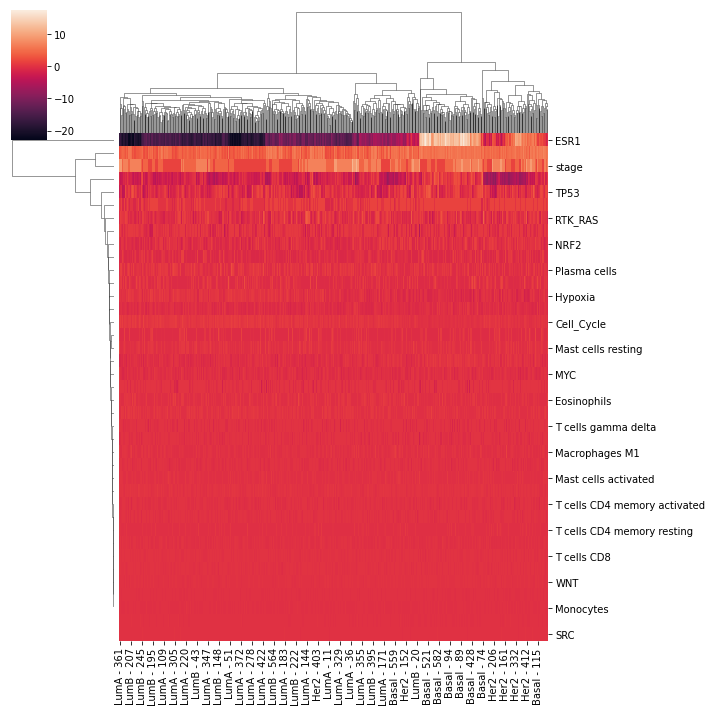

In [13]:
import seaborn as sns
df_all_transposed = df3.transpose()
sns.clustermap(df_all_transposed)

In [29]:
import plotly.graph_objects as go

def df_to_plotly(df):
    return {'z': df3.values.tolist(),
            'x': df3.columns.tolist(),
            'y': df3.index.tolist()}

df3 = df3[features].transpose()
fig = go.Figure(data=go.Heatmap(df_to_plotly(df3),colorscale="Plasma"))
fig.update_layout(
    autosize=False,
    width=1500,
    height=800,
    title_text='Saliency Values', title_x=0.5,
    title_font=dict(
        family="Courier New, monospace",
        size=24,
        color="RebeccaPurple"
    ),
    yaxis=dict(
        title_text="Patient"
    ),
    xaxis=dict(
        title_text="Variable"
    ),
    margin=dict(
        l=50,
        r=50,
        b=100,
        t=100,
        pad=4
    ),
    paper_bgcolor="LightSteelBlue",)

fig.show()

In [21]:
df3

,Basal - 101,Basal - 107,Basal - 110,Basal - 113,Basal - 114,Basal - 115,Basal - 123,Basal - 125,Basal - 130,Basal - 131,...,LumB - 58,LumB - 67,LumB - 7,LumB - 76,LumB - 77,LumB - 78,LumB - 8,LumB - 85,LumB - 98,LumB - 99
B cells naive,0.159784,0.159784,0.130975,0.159784,-0.503616,0.159784,-0.273290,0.159784,0.016877,0.159784,...,0.159784,-0.076008,0.130729,-0.626843,-0.086426,-0.118737,0.159784,0.116963,0.159784,-0.341315
B cells memory,1.305086,0.469790,0.043377,0.508701,-0.551392,1.908768,-0.068580,-0.220390,0.221080,0.910672,...,1.993517,-0.223844,0.078205,-0.551392,-0.551392,-0.052613,0.547389,-0.312156,-0.307634,-0.551392
Plasma cells,-0.076001,-0.666637,-0.544496,0.392944,0.078444,-0.666637,1.278921,0.660562,0.852994,-0.666637,...,0.818317,0.987430,1.144890,0.519638,-0.666637,1.136423,0.315991,0.334899,1.914159,0.105029
T cells CD8,-0.012178,0.237273,-0.279175,0.069697,-0.076675,-0.216179,0.103574,-0.099523,0.237273,0.100192,...,-0.023543,0.237273,0.217755,0.114833,0.193968,0.237273,0.157824,-0.088425,0.180815,0.114833
T cells CD4 naive,-0.138892,0.172667,-0.138892,0.478771,-0.138892,-0.053317,0.234879,-0.018571,0.415243,-0.138892,...,-0.138892,0.050262,0.745198,-0.138892,-0.138892,-0.138892,0.503519,0.230966,0.542804,0.579019
T cells CD4 memory resting,-0.065414,-0.114823,-0.114823,-0.114823,-0.114823,-0.114823,-0.114823,-0.114823,-0.114823,-0.114823,...,-0.114823,-0.114823,-0.114823,-0.114823,0.427032,0.279364,-0.114823,-0.114823,-0.114823,-0.114823
T cells CD4 memory activated,-0.108258,0.161709,-0.408057,-0.184812,0.161709,-0.131519,-0.063643,-0.049527,-0.350714,-0.093510,...,0.161709,0.161709,-0.247621,0.161709,0.141055,0.161709,-0.205824,-0.117033,-0.016866,0.161709
T cells follicular helper,0.154074,-0.596427,0.256203,-0.784526,0.377798,-0.257110,-0.378786,0.204249,-0.865909,1.565424,...,0.155014,0.025932,-0.865909,-0.865909,-0.458779,-0.002068,-0.336501,-0.728783,0.119261,1.092732
T cells regulatory (Tregs),0.332198,0.332198,0.332198,-0.397571,0.067896,0.332198,0.332198,0.332198,0.332198,0.332198,...,0.332198,0.098327,-0.500249,0.174954,-0.066412,0.262479,-0.006268,0.332198,0.332198,0.332198
T cells gamma delta,0.162241,-1.139182,0.162241,-0.057221,0.162241,0.162241,-0.288236,0.162241,-0.487568,0.162241,...,0.162241,-0.661850,-0.086735,0.162241,-0.508201,0.162241,0.162241,0.162241,0.162241,0.094138


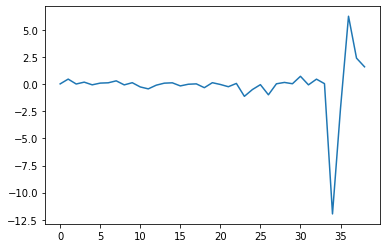

In [16]:
plt.plot(a[0][1870])
plt.show()

In [44]:
X_train = torch.rand((1000, 4))
x1 = X_train[:,0]
x2 = X_train[:,1]
y_train = np.power(x1,2)-x2

In [51]:
X_train

tensor([[0.3311, 0.7527, 0.4053, 0.5998],
        [0.4391, 0.9302, 0.4550, 0.6212],
        [0.3033, 0.4911, 0.1101, 0.0382],
        ...,
        [0.9646, 0.3833, 0.9514, 0.3544],
        [0.7766, 0.8494, 0.1817, 0.7334],
        [0.8237, 0.8942, 0.1328, 0.8139]])

In [26]:
#X1 = 2*torch.rand((1000, 1))
#X2 = 8*torch.rand((1000, 1))
#X3 = torch.rand((1000, 1))
#X4 = 12*torch.rand((1000, 1))
#X_train = torch.cat([X1,X2,X3,X4],1)
#x1 = X_train[:,0]
#x2 = X_train[:,1]
#y_train = np.power(x1,2)-x2

In [45]:


class LinearNet(nn.Module):
    def __init__(self,n_feature):
        super(LinearNet,self).__init__()
        self.linear = nn.Linear(n_feature,1)
    def forward(self,x):
        y = self.linear(x)
        return y

def batch_generator(idata, target, batch_size, shuffle=True):
    nsamples = len(idata)
    if shuffle:
        perm = np.random.permutation(nsamples)
    else:
        perm = range(nsamples)

    for i in range(0, nsamples, batch_size):
        batch_idx = perm[i:i+batch_size]
        if target is not None:
            yield idata[batch_idx], target[batch_idx]
        else:
            yield idata[batch_idx], None

In [46]:
net = nn.Sequential(
    nn.Linear(4,1))
    
loss = nn.MSELoss()
optimizer = optim.Adam(net.parameters(),lr = 0.03)
num_epochs = 15

for epoch in range(1,num_epochs + 1):
    for X, y in batch_generator(X_train, y_train, 50, shuffle=True):
        output = net(X)
        l = loss(output, y.view(-1,1)) 
        optimizer.zero_grad() 
        l.backward()
        optimizer.step () 
        print('epoch %d ,loss:%f '% (epoch,l.item()))

epoch 1 ,loss:0.239416 
epoch 1 ,loss:0.182219 
epoch 1 ,loss:0.181841 
epoch 1 ,loss:0.176457 
epoch 1 ,loss:0.146824 
epoch 1 ,loss:0.122767 
epoch 1 ,loss:0.153226 
epoch 1 ,loss:0.080673 
epoch 1 ,loss:0.151295 
epoch 1 ,loss:0.166128 
epoch 1 ,loss:0.111918 
epoch 1 ,loss:0.098263 
epoch 1 ,loss:0.126981 
epoch 1 ,loss:0.085111 
epoch 1 ,loss:0.087711 
epoch 1 ,loss:0.075493 
epoch 1 ,loss:0.076294 
epoch 1 ,loss:0.064087 
epoch 1 ,loss:0.052366 
epoch 1 ,loss:0.055949 
epoch 2 ,loss:0.040675 
epoch 2 ,loss:0.061782 
epoch 2 ,loss:0.059725 
epoch 2 ,loss:0.038054 
epoch 2 ,loss:0.042374 
epoch 2 ,loss:0.040163 
epoch 2 ,loss:0.027714 
epoch 2 ,loss:0.038092 
epoch 2 ,loss:0.024448 
epoch 2 ,loss:0.020996 
epoch 2 ,loss:0.027600 
epoch 2 ,loss:0.017178 
epoch 2 ,loss:0.020642 
epoch 2 ,loss:0.019297 
epoch 2 ,loss:0.011701 
epoch 2 ,loss:0.015539 
epoch 2 ,loss:0.014413 
epoch 2 ,loss:0.011504 
epoch 2 ,loss:0.011364 
epoch 2 ,loss:0.012321 
epoch 3 ,loss:0.010767 
epoch 3 ,loss:0.

In [47]:
x1 = X_train[1,0]
x2 = X_train[1,1]
y_train = np.power(x1,2)-x2
print(y_train)
print(net(X_train[1]))

tensor(-0.7373, dtype=torch.float64)
tensor([-0.6477], grad_fn=<AddBackward0>)


In [50]:
background = X_train[np.random.choice(X_train.shape[0], 100, replace=False)]
e = shap.DeepExplainer(net, background)

# shap_values(X, ranked_outputs=None, output_rank_order='max', check_additivity=True)
# X: A tensor (or list of tensors) of samples (where X.shape[0] == # samples) on which to explain the model’s output.
# ranked_outputs: If ranked_outputs is a positive integer then we only explain that many of the top model outputs (where “top” is determined by output_rank_order).

list_of_tensors = X_train[1:10]
ranked_outputs = 4

shap_values = e.shap_values(list_of_tensors,ranked_outputs)
shap_values

array([[-1.00653790e-01, -4.52831179e-01, -5.29086916e-04,
         6.08180999e-04],
       [-2.36926764e-01, -2.11500544e-02, -3.38004297e-03,
        -1.17543293e-03],
       [ 1.58884421e-01, -4.28591013e-01,  1.97790447e-03,
        -7.74086104e-04],
       [-1.89170763e-02,  1.13420442e-01, -3.77391884e-03,
        -4.37095121e-04],
       [-1.18875941e-02, -1.82005867e-01, -9.51185648e-05,
         6.49078807e-04],
       [-1.93928525e-01,  1.23888351e-01, -6.05345878e-04,
        -9.16281657e-04],
       [ 1.45089522e-01,  2.72531539e-01,  1.00721093e-03,
        -4.89922415e-04],
       [-5.11457801e-01,  2.29093321e-02,  2.02834909e-03,
         7.40489690e-04],
       [-4.26449060e-01, -3.36932689e-01,  3.21608712e-03,
         3.74590396e-04]])

In [252]:
X_train[1:10]

tensor([[0.4428, 0.7062, 0.4931, 0.2310],
        [0.5867, 0.7624, 0.9791, 0.0221],
        [0.8453, 0.1242, 0.1268, 0.5850],
        [0.3138, 0.6668, 0.0782, 0.3015],
        [0.0078, 0.9760, 0.1212, 0.7673],
        [0.8687, 0.2212, 0.8998, 0.2652],
        [0.2013, 0.9388, 0.9639, 0.7013],
        [0.1963, 0.1314, 0.5001, 0.3831],
        [0.7282, 0.2962, 0.4115, 0.6431]])

In [119]:
import copy
import json
import sys
from collections import OrderedDict
from collections import defaultdict

pathways = ['Cell_Cycle',
      'HIPPO', 'MYC', 'NOTCH', 'NRF2', 'PI3K', 'TGF.Beta', 'RTK_RAS', 'TP53',
      'WNT', 'Hypoxia', 'SRC', 'ESR1', 'ERBB2']
immune_cells = ['B cells naive', 'B cells memory', 'Plasma cells', 'T cells CD8',
      'T cells CD4 naive', 'T cells CD4 memory resting',
      'T cells CD4 memory activated', 'T cells follicular helper',
      'T cells regulatory (Tregs)', 'T cells gamma delta', 'NK cells resting',
      'NK cells activated', 'Monocytes', 'Macrophages M0', 'Macrophages M1',
      'Macrophages M2', 'Dendritic cells resting',
      'Dendritic cells activated', 'Mast cells resting',
      'Mast cells activated', 'Eosinophils', 'Neutrophils']

comb = []

def flatten(A):
    rt = []
    for i in A:
        if isinstance(i,list): rt.extend(flatten(i))
        else: rt.append(i)
    return rt

def combinations(target,data):
    for i in range(len(data)):
        new_target = copy.copy(target)
        new_data = copy.copy(data)
        new_target.append(data[i])
        new_data = data[i+1:]  
        if pathways in new_target:            
            el = flatten(new_target)
            comb.append(el)   
        combinations(new_target,new_data)
    return comb

def hyperparam_selection():
    params = {}
    hyper_lr = [0.01, 0.001]
    hyper_epochs = [80, 100, 120]
    hyper_batch_size = [100, 150, 200]
    hyper_net = [[40, 20, 10],[200, 120, 84]]
    hyper_dropout = [0, 0.1, 0.2]
    accuracy = [90, 60, 100]
    
    target = [pathways, immune_cells,'PROLIF',['stage','grade']]
    features = combinations(comb,target)

    feature_dic = {str(v)+"_features.txt": k for v, k in enumerate(features)}

    with open('feature_dic.json', 'w') as fp:
        json.dump(feature_dic, fp)

    acccs = defaultdict(list)
    for filename, features in feature_dic.items():
        sys.stdout = open("model/"+filename,'wt')
        for lr in hyper_lr:
            for epochs in hyper_epochs:
                for batch_size in hyper_batch_size:
                    for fc in hyper_net:
                        for dropout in hyper_dropout:
                            for acc in accuracy:
                                params = {  
                                    'lr':lr,
                                    'epochs':epochs,
                                    'batch_size':batch_size,
                                    'fc1':fc[0],
                                    'fc2':fc[1],
                                    'fc3':fc[2],
                                    'dropout':dropout
                                }
                                acccs[acc].append(params)
                                print("[PARAMETERS]:--------------")
                                print(params)
                                print("---------------------------")
    sys.stdout = open("model/results.txt",'wt')
    ordered = OrderedDict(sorted(acccs.items(), key=lambda t: t[0], reverse=True))
    print({k: ordered[k] for k in list(ordered)[:1]})

In [4]:
hyperparam_selection()

In [33]:
import copy
def flatten(A):
    rt = []
    for i in A:
        if isinstance(i,list): rt.extend(flatten(i))
        else: rt.append(i)
    return rt

comb = []
def combinations(target,data):
    for i in range(len(data)):
        new_target = copy.copy(target)
        new_data = copy.copy(data)
        new_target.append(data[i])
        new_data = data[i+1:]  
        combinations(new_target,new_data)
        if ['a'] in new_target:            
            el = flatten(new_target)
            comb.append(el)   
    return comb  

data = [['a'], ['b'],'PROLIF',['stage','grade']] 
comb = combinations([],data)
comb

[['a', 'b', 'PROLIF', 'stage', 'grade'],
 ['a', 'b', 'PROLIF'],
 ['a', 'b', 'stage', 'grade'],
 ['a', 'b'],
 ['a', 'PROLIF', 'stage', 'grade'],
 ['a', 'PROLIF'],
 ['a', 'stage', 'grade'],
 ['a']]

In [14]:
import functools
import numpy as np
from scipy.stats import entropy
from scipy.spatial import cKDTree
from scipy.special import gamma, digamma
from scipy.stats   import rankdata
from sklearn import preprocessing
from sklearn.preprocessing import KBinsDiscretizer

In [15]:
data = pd.read_csv(DATA_PATH)
data['PAM50'] = data['PAM50'].astype('category')
data['PAM50'] = data['PAM50'].cat.codes.values

X = data[['B cells naive', 'B cells memory', 'Plasma cells', 'T cells CD8',
       'T cells CD4 naive', 'T cells CD4 memory resting',
       'T cells CD4 memory activated', 'T cells follicular helper',
       'T cells regulatory (Tregs)', 'T cells gamma delta', 'NK cells resting',
       'NK cells activated', 'Monocytes', 'Macrophages M0', 'Macrophages M1',
       'Macrophages M2', 'Dendritic cells resting',
       'Dendritic cells activated', 'Mast cells resting',
       'Mast cells activated', 'Eosinophils', 'Neutrophils', 'Cell_Cycle',
       'HIPPO', 'MYC', 'NOTCH', 'NRF2', 'PI3K', 'TGF.Beta', 'RTK_RAS', 'TP53',
       'WNT', 'Hypoxia', 'SRC', 'ESR1', 'ERBB2', 'PROLIF']]
y = data["PAM50"]

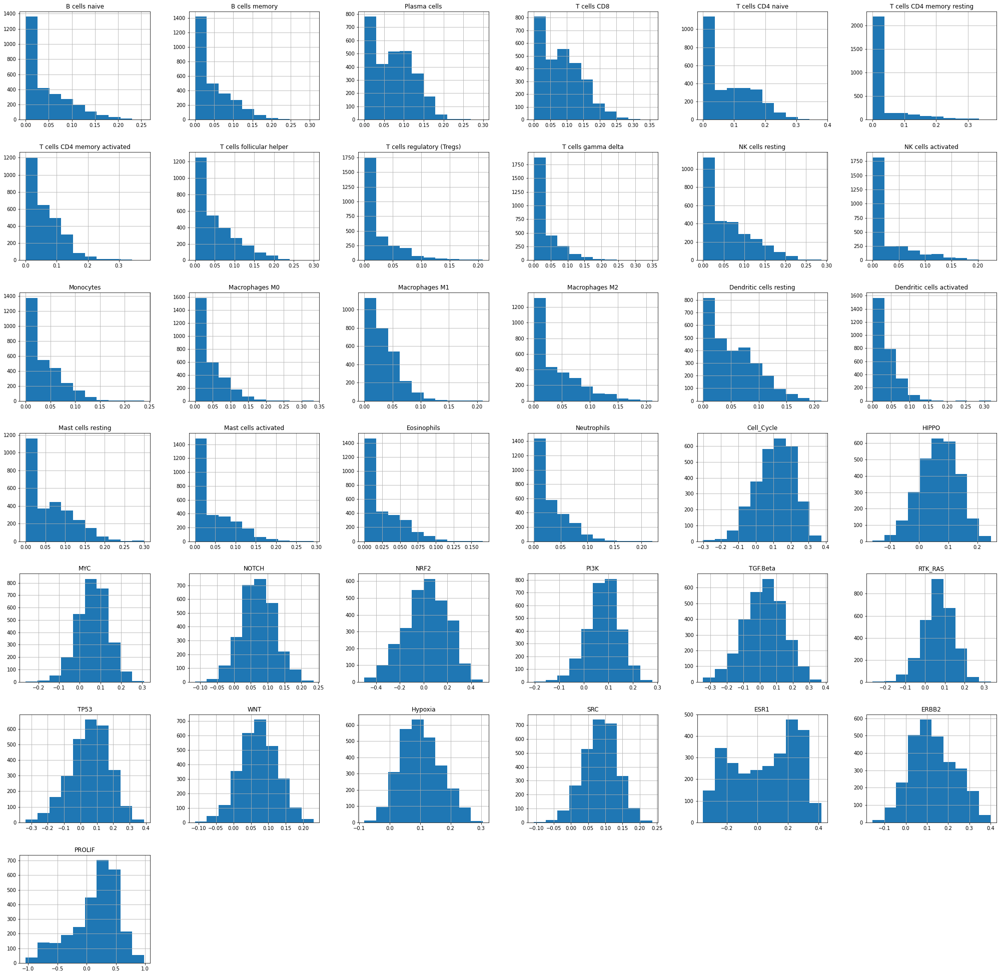

In [153]:
import matplotlib.pyplot as plt
X.hist()
plt.rcParams["figure.figsize"] = [35,35]
plt.show()

In [16]:
kbins = KBinsDiscretizer(n_bins=10, encode='ordinal', strategy='uniform')
X_binned = kbins.fit_transform(X)

In [17]:
entropy(X_binned)

array([7.09790684, 7.06883557, 7.49366959, 7.46292616, 7.28397451,
       6.250612  , 7.22020218, 7.17211438, 6.75419983, 6.65742286,
       7.25339292, 6.71217621, 7.11779135, 6.95928954, 7.28393696,
       7.12753092, 7.4319865 , 7.01035566, 7.25690542, 7.03385377,
       7.04910873, 7.06560453, 7.89300656, 7.88300389, 7.90591031,
       7.89278539, 7.85685106, 7.90401213, 7.86357127, 7.90587968,
       7.87498043, 7.88315568, 7.85588089, 7.89669596, 7.74195499,
       7.85171967, 7.85533035])

In [18]:
entropy(y)

7.565586124641883

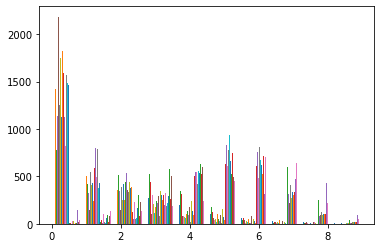

In [19]:
from matplotlib import pyplot
pyplot.hist(X_binned, bins=10)
pyplot.show()

In [173]:
# https://stackoverflow.com/questions/45591968/how-to-find-entropy-of-continuous-variable-in-python

def get_h(x, k=1, norm='max', min_dist=0):
    """
    Estimates the entropy H of a random variable x (in nats) based on
    the kth-nearest neighbour distances between point samples.
    @reference:
    Kozachenko, L., & Leonenko, N. (1987). Sample estimate of the entropy of a random vector. Problemy Peredachi Informatsii, 23(2), 9–16.
    Arguments:
    ----------
    x: (n, d) ndarray
        n samples from a d-dimensional multivariate distribution
    k: int (default 1)
        kth nearest neighbour to use in density estimate;
        imposes smoothness on the underlying probability distribution
    norm: 'euclidean' or 'max'
        p-norm used when computing k-nearest neighbour distances
    min_dist: float (default 0.)
        minimum distance between data points;
        smaller distances will be capped using this value
    Returns:
    --------
    h: float
        entropy H(X)
    """

    n, d = x.shape

    if norm == 'max': # max norm:
        p = np.inf
        log_c_d = 0 # volume of the d-dimensional unit ball
    elif norm == 'euclidean': # euclidean norm
        p = 2
        log_c_d = (d/2.) * log(np.pi) -log(gamma(d/2. +1))
    else:
        raise NotImplementedError("Variable 'norm' either 'max' or 'euclidean'")

    kdtree = cKDTree(x)

    # query all points -- k+1 as query point also in initial set
    # distances, _ = kdtree.query(x, k + 1, eps=0, p=norm)
    distances, _ = kdtree.query(x, k + 1, eps=0, p=p)
    distances = distances[:, -1]

    # enforce non-zero distances
    distances[distances < min_dist] = min_dist

    sum_log_dist = np.sum(np.log2(np.where(2*distances > 0, 2*distances, 1))) # where did the 2 come from? radius -> diameter
    print(sum_log_dist)
    #h = -digamma(k) + digamma(n) + log_c_d + (d / float(n)) * sum_log_dist

    return distances,h

In [174]:
get_h(X.to_numpy())

-12365.799822170498


(array([0.07389477, 0.02824811, 0.06412628, ..., 0.0148475 , 0.02909001,
        0.04225161]),
 -88.43554851757548)

In [57]:
print(d)

[0.13904192 0.15350369 0.10839175 ... 0.13901312 0.1317537  0.1458672 ]


In [12]:
def treatment(x):
    ht = 0
    rt = 0
    ct = 0
    Treatment = x.split("/")
    if 'HT' in Treatment:
        ht = 1
    if 'RT' in Treatment:
        rt = 1
    if 'CT' in Treatment:
        ct = 1
    return ht, rt, ct

df["HT"], df["RT"], df["CT"] = zip(*df["Treatment"].map(treatment))

In [13]:
df

,submitter,B cells naive,B cells memory,Plasma cells,T cells CD8,T cells CD4 naive,T cells CD4 memory resting,T cells CD4 memory activated,T cells follicular helper,T cells regulatory (Tregs),...,lymph_nodes_positive,Treatment,TP53.mut,PIK3CA.mut,NPI,CELLULARITY,INTCLUST,HT,RT,CT
0,MB-0002,0.069373,0.000000,0.208345,0.000000,0.196418,0.000000,0.000000,0.000000,0.000000,...,0.0,HT/RT,MUT,WT,4.020,High,4ER+,1,1,0
1,MB-0005,0.000000,0.064343,0.066266,0.066700,0.000000,0.167435,0.103641,0.000000,0.095029,...,1.0,CT/HT,WT,MUT,4.030,High,3,1,0,1
2,MB-0006,0.000000,0.103456,0.000760,0.179958,0.143445,0.000000,0.146302,0.000000,0.000000,...,3.0,CT/HT/RT,WT,MUT,4.050,Moderate,9,1,1,1
3,MB-0008,0.052183,0.000000,0.087170,0.000000,0.000000,0.105195,0.064576,0.089692,0.054062,...,8.0,CT/HT/RT,MUT,WT,6.080,High,9,1,1,1
4,MB-0010,0.098869,0.000000,0.038915,0.046231,0.000000,0.045777,0.067479,0.071380,0.022438,...,0.0,HT/RT,MUT,MUT,4.062,Moderate,7,1,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1774,MB-7295,0.100654,0.000000,0.059485,0.040332,0.147938,0.000000,0.127725,0.102431,0.011768,...,1.0,HT/RT,WT,MUT,5.050,High,3,1,1,0
1775,MB-7296,0.063419,0.028544,0.011797,0.058478,0.062116,0.102514,0.000000,0.049919,0.000000,...,1.0,RT,MUT,WT,5.040,High,5,0,1,0
1776,MB-7297,0.177288,0.000000,0.079083,0.059766,0.001085,0.000000,0.002910,0.142864,0.000000,...,45.0,HT/RT,WT,WT,6.050,High,1,1,1,0
1777,MB-7298,0.096277,0.067046,0.053489,0.150414,0.000000,0.112773,0.000000,0.044067,0.049082,...,12.0,HT,WT,WT,5.050,Moderate,1,1,0,0


In [34]:
import pandas as pd
GENERATED_FOLDER = "data/generated/"
DATA_PATH = GENERATED_FOLDER + "clean_train.csv"

data = pd.read_csv(DATA_PATH)
data["binned_RFS"] = data["RFS"].astype(int).astype("category")

In [41]:
data['class'] = 5
data.loc[(data['RFS']<=1830) & (data['RFSE'] == 0), 'class'] = 0 
data.loc[(data['RFS']<=1830) & (data['RFSE'] == 1), 'class'] = 1
data.loc[(data['RFS']>1830) & (data['RFS']<3660) & (data['RFSE'] == 0), 'class'] = 2 
data.loc[(data['RFS']>1830) & (data['RFS']<3660) & (data['RFSE'] == 1), 'class'] = 3 

In [42]:
data.loc[(data['RFS']>1830) & (data['RFS']<3660) & (data['RFSE'] == 0), 'class']

1       2
5       2
6       2
9       2
10      2
       ..
1689    2
1696    2
1702    2
1723    2
1751    2
Name: class, Length: 430, dtype: int64